## Chapter 6
# Digital Waveguide Models

## Ideal Vibrating String

The ideal vibrating string is assumed to be perfectly flexible and elastic, and vibrates forever in one plane after excitation.

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

import sys
sys.path.append('../')
from ipython_animation import create_animation, DEFAULT_FPS

%matplotlib inline
_ = np.seterr(divide='ignore', invalid='ignore')
matplotlib.rcParams['figure.figsize'] = [14, 5]

In [2]:
K = 1 # string tension
eps = 1 # linear mass density
c = np.sqrt(K / eps) # traveling wave speed

L = 21 # length of "string" in samples
N = L * 2 # length of full delay loop in samples (one full wave period)

def animate_traveling_wave(y_l, y_r):
    fig, (y_plot, y_components_plot) = plt.subplots(2, 1, figsize=(14, 10))
    y_l_ax, = y_components_plot.plot(y_l, label='$y_l$', linestyle='--', c='r', alpha=0.7, linewidth=2)
    y_r_ax, = y_components_plot.plot(y_r, label='$y_r$', linestyle='--', c='b', alpha=0.7, linewidth=2)
    y_ax, = y_plot.plot(y_l + y_r, label='$y_l + y_r$', linewidth=3, c='b')

    y_plot.set_title('Traveling waves', size=16)

    for plot in [y_plot, y_components_plot]:
        plot.legend()
        plot.grid(True)
        plot.set_xlabel('$x$')
        plot.set_ylabel('$y$')
        plot.set_ylim(-1, 1)
        plot.set_xlim(0, L - 1)
        plot.set_xticks(2 * np.arange(L // 2 + 1))

    def get_or_zero(a, index):
        return a[int(index)] if index < len(a) and index >= 0 else 0

    def animate(frame):
        t = int(frame)
        # only works for integer c (no interpolation)
        y_l_t = np.array([get_or_zero(y_l, x / c + t) for x in range(L)])
        y_r_t = np.array([get_or_zero(y_r, x / c - t) for x in range(L)])
        y_l_ax.set_ydata(y_l_t)
        y_r_ax.set_ydata(y_r_t)
        y_ax.set_ydata(y_l_t + y_r_t)

    return create_animation(fig, plt, animate, frames=L, frames_per_second=10)

In [3]:
y_l = np.zeros(L) # left-traveling wave component y positions
# make a "pluck" triangle for initial state
y_l[L // 4 + 1:L // 2 + 1] = np.linspace(0, 0.5, L // 4)
y_l[L // 2:3 * L // 4] = np.linspace(0.5, 0, L // 4)

y_r = y_l.copy() # right-traveling wave component (initial state identical to left-traveling component)

animate_traveling_wave(y_l, y_r)

### Rigid terminations

If we have rigid terminations at both ends of the string, we can model the string with two finite delay lines - one for each of the left- and right-going traveling wave components.

In [4]:
def animate_rigid_string_with_delay_lines(L, d_l, d_r, gain=1.0, pickup_x=None, wave_variable_name='y', num_frames=None):
    num_frames = num_frames or (L - 1) * 2

    if pickup_x is not None:
        fig, (y_plot, y_r_plot, y_l_plot, pickup_plot) = plt.subplots(4, 1, figsize=(14, 4 * 3))
    else:
        fig, (y_plot, y_r_plot, y_l_plot) = plt.subplots(3, 1, figsize=(14, 3 * 3))

    y_r_ax, = y_r_plot.plot(d_r.get_all()[::-1], label='${}_r$'.format(wave_variable_name), linestyle='--', c='b', alpha=0.7, linewidth=2)
    y_l_ax, = y_l_plot.plot(d_l.get_all(), label='${}_l$'.format(wave_variable_name), linestyle='--', c='b', alpha=0.7, linewidth=2)
    y_ax, = y_plot.plot(d_r.get_all()[::-1] + d_l.get_all(), label='${0}_l + {0}_r$'.format(wave_variable_name), linewidth=3, c='b')

    y_plot.set_title('${0}(t,x) = {0}_r(t,x) + {0}_l(t,x)$'.format(wave_variable_name), size=16)
    y_r_plot.set_title('${}_r(t,x)$'.format(wave_variable_name), size=16)
    y_l_plot.set_title('${}_l(t,x)$'.format(wave_variable_name), size=16)

    if pickup_x is not None:
        for plot in [y_r_plot, y_l_plot]:
            plot.axvline(pickup_x, label='Pickup $x$', linewidth=3, c='black')
        pickup_data = np.zeros(num_frames)
        pickup_data[0] = d_l.get_tap(pickup_x) + d_r.get_tap(L - pickup_x)
        pickup_ax, = pickup_plot.plot(pickup_data)
        pickup_plot.set_xlim(0, num_frames - 1)
        pickup_plot.set_ylim(-1.2, 1.2)
        pickup_plot.grid(True)
        pickup_plot.set_title('Signal from pickup at $x={}$'.format(pickup_x), size=16)
        pickup_plot.set_xlabel('$t \\longrightarrow$')

    for plot in [y_plot, y_r_plot, y_l_plot]:
        plot.legend()
        plot.grid(True)
        plot.set_ylabel('$y$')
        plot.set_ylim(-1.2, 1.2)
        plot.set_xlim(0, L - 1)
        plot.set_xticks(np.arange(L))

    y_plot.set_xlabel('$x$')
    for plot in [y_r_plot, y_l_plot]:
        plot.set_xlabel('Delay Line Sample Index')

    y_r_plot.set_xticklabels(np.arange(L)[::-1])
    plt.tight_layout()

    def animate(frame):
        if frame < 1:
            return

        r = d_r.get_tap(1) # get least recent sample from rightgoing wave component
        l = d_l.get_tap(1) # get least recent sample from leftgoing wave component
        d_l.tick(-r * gain) # reflect at right rigid termination and apply gain
        d_r.tick(-l * gain) # reflect at left rigid termination and apply gain

        y_r_x = np.roll(np.arange(L), -d_l.read_sample)[::-1]
        y_r = d_r.get_all()[y_r_x]
        y_r_ax.set_ydata(y_r)
        y_r_plot.set_xticklabels(y_r_x)

        y_l_x = np.roll(np.arange(L), -d_l.read_sample)
        y_l = d_l.get_all()[y_l_x]
        y_l_ax.set_ydata(y_l)
        y_l_plot.set_xticklabels(y_l_x)

        y_ax.set_ydata(y_r + y_l)

        if pickup_x:
            pickup_data[frame] = d_l.get_tap(pickup_x) + d_r.get_tap(L - pickup_x)
            pickup_ax.set_ydata(pickup_data)

    return create_animation(fig, plt, animate, frames=num_frames, frames_per_second=10)

## The Idea Plucked String

The following two examples are both arranged to reproduce this image in the book on p218:
![](https://ccrma.stanford.edu/~jos/pasp/img1390.png)

Two different initial "string" displacements are animated. The axes and units are intended to reflect the way things are working under the hood - two separate delay lines are fed into each other, with the rightgoing wave component $y_r(t,x)$ arranged "backwards". The read-pointer indices are always the leftmost index, and the write pointer is on the right edge. In this way, each delay line grabs the least-recently written sample from the other, flip it (due to a sign inversion at the rigid termination), and feeds it into itself.

In [5]:
from DelayLine import DelayLine
d_l = DelayLine(L)
d_r = DelayLine(L)
d_r.tick_all(y_r[::-1])
d_l.tick_all(y_l)
animate_rigid_string_with_delay_lines(L, d_l, d_r)

In [6]:
pluck_shape = np.zeros(L)
pluck_shape[1:] = np.linspace(0.5, 0, L - 1)
d_r.set_all(pluck_shape[::-1])
d_l.set_all(pluck_shape)
animate_rigid_string_with_delay_lines(L, d_l, d_r)

## The Ideal Struck String

![](https://ccrma.stanford.edu/~jos/pasp/img1405.png)

Other wave variables can be modeled in the same way. For example, we can model the propagation of the velocity by using the wave variable $v(t, x)$ instead of displacement. Like displacement waves, velocity waves change sign at rigid string terminations (although some wave variables, like force, do not change sign like this).

Let's set up the initial conditions to model the propagation of velocity after a hammer strikes a string. We will simplify the situation by assuming the hammer strikes the string evenly across its surface.

In [7]:
hammer_shape = np.zeros(L)
hammer_shape[5:9] = 0.5
d_r.set_all(hammer_shape[::-1])
d_l.set_all(hammer_shape)
animate_rigid_string_with_delay_lines(L, d_l, d_r, wave_variable_name='v')

## Pickup

A simple pickup can be simulated by simply summing up the wave components at a given x coordinate. We just sample and sum from the appropriate position along the delay lines:

In [8]:
pluck_shape = np.zeros(L)
pluck_shape[5:9] = np.linspace(0, 0.5, 4)
pluck_shape[8:12] = np.linspace(0.5, 0, 4)
d_r.set_all(pluck_shape[::-1])
d_l.set_all(pluck_shape)
animate_rigid_string_with_delay_lines(L, d_l, d_r, pickup_x=5)

The last plot shows the signal registered by the "pickup" at position $x=5$.

This initial shape represents something vaguely similar to the instant after a narrow impulse (except with 0 initial velocity, and of course the sharp "kinks" are physically impossible and would result in aliased frequencies since the shape isn't bandlimited). For a more harmonic shape, we can set the starting position to be the fundamental mode:

In [9]:
pluck_shape = 0.5 * np.sin(np.linspace(0, np.pi, L))
d_r.set_all(pluck_shape[::-1])
d_l.set_all(pluck_shape)
animate_rigid_string_with_delay_lines(L, d_l, d_r, pickup_x=5)

Just for funsees, how bout making a more realistically curved pluck shape by taking the first 10 harminic components of a triangle (just using a cheeky kind of bandlimiting to smooth it):

In [10]:
pluck_shape = np.zeros(L)
pluck_shape[:4] = np.linspace(0, 0.5, 4)
pluck_shape[3:] = np.linspace(0.5, 0, L - 3)
pluck_shape = np.fft.irfft(np.fft.rfft(np.concatenate([pluck_shape, -pluck_shape[::-1]]))[:10], L * 2)[:L]
pluck_shape[0] = pluck_shape[-1] = 0 # make sure ends are exactly zero (they're very close without this1)
d_r.set_all(pluck_shape[::-1])
d_l.set_all(pluck_shape)
animate_rigid_string_with_delay_lines(L, d_l, d_r, pickup_x=5)

## The Damped Plucked String

The waveguide model as it is now will just loop forever as a periodic tone. In order to have the sound decay, we need to add some kind of damping. One way to do this is to add damping at each of the terminations (in addition to the sign flip). Note however (I was scratching my head over this!) that the physical wave model is invalidated with this modification, in the sense that adding the two delay lines together no longer sum to a "damped" string position. To see why, realize that the damping at the termination points (and into the delay lines) has to travel through the full delay line before that sample is multiplied again by the damping factor. Since the gain isn't applied to all the string samples at once, the values in the different delay lines will scale at different times and will result in a wave shape that can no longer be interpretted as a solution to the wave equation. (For example, the string no longer maintains its zeros at the two ends

To see this in action, let's let the model run for a few cycles with sine-wave initial string position. We'll put the pickup at the fifth sample from the left.

In [11]:
initial_shape = 0.5 * np.sin(np.linspace(0, 2 * np.pi, L))
d_r.set_all(initial_shape[::-1])
d_l.set_all(initial_shape)
animate_rigid_string_with_delay_lines(L, d_l, d_r, pickup_x=5, gain=0.6, num_frames = L * 5) # run for 5 periods

### Listening to the results

Let's hear what it sounds like so far! I'll make a few different tones by moving the pickup position and rendering a note:

In [12]:
fs = 44100
frequency = 440 # note that due to rounding to integer sample lengths, the actual tone won't be exatcly A440
N = (fs // frequency) // 2 # one full loop through both delay lines creates a period of the signal
# I was banging my head against this forever. Notice the `d_r.get_tap(1)` above to get the least recently written sample. I don't know if this totally makes sense - I would think just `get()` would do it, but it doesn't actually fulfill the wave equation and the animations have a one-off error. This effectively shortens the delay length by one sample, so to get accurate pitch I use `+ 1` here.
delay_length = N + 1
tone_length_samples = fs * 4
gain = 0.995

d_l = DelayLine(delay_length)
d_r = DelayLine(delay_length)
# make a triangle pluck shape
pluck_shape = np.concatenate([np.linspace(0, 0.2, delay_length // 4), np.linspace(0.2, 0, 3 * delay_length // 4)])
d_r.set_all(pluck_shape[::-1])
d_l.set_all(pluck_shape)

# different pickup positions along the "string", starting at the "nut"
tones = {}
for pickup_x in np.arange(4) * delay_length // 5:
    tone = np.zeros(tone_length_samples)
    for sample in range(tone.size):
        # get least recent samples from left and rightgoing wave components
        r = d_r.get_tap(1)
        l = d_l.get_tap(1)
        # reflect at rigid termination sand apply gain
        d_l.tick(-r * gain)
        d_r.tick(-l * gain)
        tone[sample] = d_l.get_tap(pickup_x) + d_r.get_tap(delay_length - pickup_x)
    tones[pickup_x] = tone

In [13]:
from IPython import display
pickup_xs = list(tones.keys())
print('Tone for pickup_x: ', pickup_xs[0])
display.Audio(tones[pickup_xs[0]], rate=fs)

Tone for pickup_x:  0


In [14]:
print('Tone for pickup_x: ', pickup_xs[1])
display.Audio(tones[pickup_xs[1]], rate=fs)

Tone for pickup_x:  10


In [15]:
print('Tone for pickup_x: ', pickup_xs[2])
display.Audio(tones[pickup_xs[2]], rate=fs)

Tone for pickup_x:  20


In [16]:
print('Tone for pickup_x: ', pickup_xs[3])
display.Audio(tones[pickup_xs[3]], rate=fs)

Tone for pickup_x:  30


No surprise that this doesn't sound even a little bit guitar-y. But dammit, it still feels good.

If we go further in foregoing the original goal of simulating a physical string position $y(x,t)$, we can get a lot of computational savings by switching to one delay line, with the gains commuted out into a single gain, and the sign flips cancelled.

![](https://ccrma.stanford.edu/~jos/pasp/img1416.png)

Unfortunately the book gives no guidance on how to now initialize the delay line so as to get a similar waveform as the pickup above. The delay output waveform will in general be quite different from the waveguide model, and the waveguide output is heavily dependent on the pickup position. Qualitatively I find the following result _very_ close to the `pickup_x: 20` example above:

In [17]:
gain = 0.995 ** 2
d = DelayLine(N * 2)
d.set_all(np.concatenate([2 * pluck_shape, -2 * pluck_shape[::-1]]))
                 
for sample in range(tone.size):
    tone[sample] = d.tick(d.get() * gain)

display.Audio(tone, rate=fs)

## Frequency-dependent Damping

In a real vibrating string, damping typically increases with frequency. We can simulate this by replacing $g^N$ in the picture above with a FIR _string loop filter_.

Some constraints on the filter mentioned in the book:
* Stability (passivity) - the filter should have a gain $\leq 1$ at all frequencies
* The phase should be _linear_ (constant delay at all frequencies) - for FIR filters this means we need only consider _symmetric_ FIR filters

Again, the book spends very little time on this, but let's just make the modification and see what it sounds like.

First, I "designed" a filter by trying a few symmetric FIR lowpass filter values that sum to 1 and finding something that looked reasonable. I came up with this:

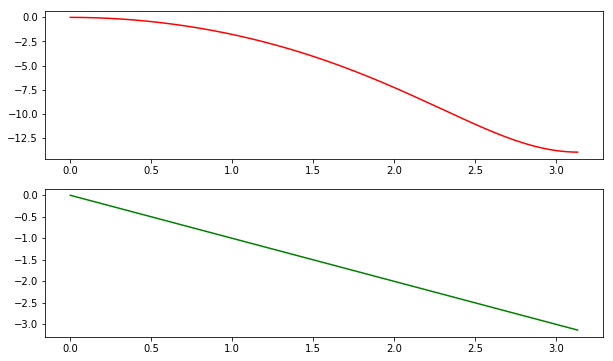

In [18]:
from scipy.signal import freqz

B = [0.2, 0.6, 0.2]
w, H = freqz(B, [1])
H_mag = 20 * np.log10(np.abs(H))
fig, (H_plot, phase_plot) = plt.subplots(2, 1, figsize=(10, 6))
H_plot.plot(w, H_mag, c='r')
_ = phase_plot.plot(w, np.angle(H), c='g')

In [19]:
from scipy.signal import lfilter, lfilter_zi

d = DelayLine(N * 2)
d.set_all(np.concatenate([2 * pluck_shape, -2 * pluck_shape[::-1]]))

z = lfilter_zi(B, 1)
for sample in range(tone.size):
    filtered_delay_out, z = lfilter(B, 1, [d.get()], zi=z)
    tone[sample] = d.tick(filtered_delay_out)

display.Audio(tone, rate=fs)

We can definitely hear the high frequencies decaying out pretty quickly, which is exactly what we designed for. However, since the DC gain is exactly 0dB, the lowest frequencies ring out for a very long time:

In [20]:
print('DC frequency magnitude: {} dB'.format(H_mag[0]))

DC frequency magnitude: 0.0 dB


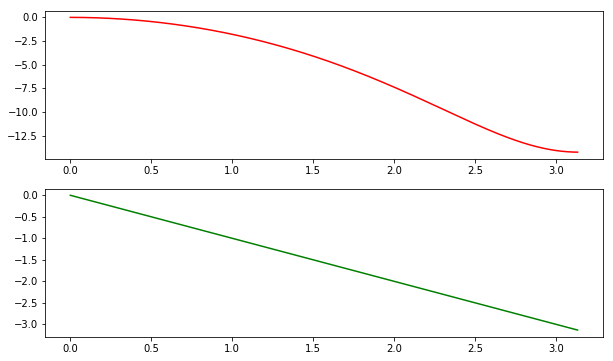

In [21]:
# Take off 0.005 from the center coefficient (representing time 0 in the time-symmetric FIR filter impulse response).
# This will keep a similar frequency response "shape", but will slightly attenuate lower all frequencies, including the dc (0 Hz) component

B = [0.2, 0.595, 0.2]
w, H = freqz(B, [1])
H_mag = 20 * np.log10(np.abs(H))
fig, (H_plot, phase_plot) = plt.subplots(2, 1, figsize=(10, 6))
H_plot.plot(w, H_mag, c='r')
_ = phase_plot.plot(w, np.angle(H), c='g')

In [22]:
print('DC frequency magnitude: {} dB'.format(H_mag[0]))

DC frequency magnitude: -0.04353838508549094 dB


In [23]:
d.set_all(np.concatenate([2 * pluck_shape, -2 * pluck_shape[::-1]]))

z = lfilter_zi(B, 1)
for sample in range(tone.size):
    filtered_delay_out, z = lfilter(B, 1, [d.get()], zi=z)
    tone[sample] = d.tick(filtered_delay_out)

display.Audio(tone, rate=fs)

I think this is a pretty decent result for how simple it is. The quick frequency-dependent decay gives it a reasonably convincing "plucky" sound!

## The Externally Excited String

Up until now we have been setting the initial displacements along the length of the string to something resembling a pluck shape. Instead, we can model the injection of an external excitation (which, depending on the wave variable of choice, can represent acceleration, velocity or displacement) somewhere along the length of the string. Using this framework we can simulate, say, a hammer or pick hitting the string. The external signal is summed into the system by splitting up the delay lines at the excitation position, as diagrammed below.

![](https://ccrma.stanford.edu/~jos/pasp/img1448.png)

The following, simplified diagram [can be shown](https://ccrma.stanford.edu/~jos/pasp/Algebraic_derivation.html) to have an equivalent transfer function:

![](https://ccrma.stanford.edu/~jos/pasp/img1454.png)

This is the diagram implemented below.

This model is a big improvement in that it allows us to inject any kind of signal at any point without reaching into the delay line(s) state. In the implementation below, a `strike_signal` array has two bursts of noise, but the excitation signal could be anything! We'll improve on this aspect in a bit.

In [24]:
strike_position = N // 5
M = strike_position
N_right = N - M

# grouped feedforward comb filter delay representing section of string to left of strike position
left_delay = DelayLine(2 * M)
right_delay = DelayLine(2 * M + 2 * N_right)

loop_filter_coefficients = B
z = lfilter_zi(loop_filter_coefficients, 1)

strike_signal = np.zeros(tone.size)
strike_signal[:100] = np.random.randn(100)
strike_signal[fs:fs + 50] = np.random.randn(50)

for t, strike_sample in enumerate(strike_signal):
    combed_strike_sample = strike_sample + left_delay.tick(strike_sample)
    filtered_delay_out, z = lfilter(loop_filter_coefficients, 1, [right_delay.get()], zi=z)
    right_delay.tick(combed_strike_sample + filtered_delay_out)

    tone[t] = right_delay.get_tap(N)

display.Audio(tone, rate=fs)

### Adding a pickup

![](https://ccrma.stanford.edu/~jos/pasp/img1462.png)

The "tap-gain" (c in diagram above) is suggested as a "musically useful timbre control that goes beyond precise physical simulation". I tried interpolating it from 1 to 2 over the course of the sound, but it really just seems to result in overall gain reduction, most likely to to phase cancellation.

The result is a small change in timbre:

In [25]:
left_delay.clear()
right_delay.clear()
z = lfilter_zi(loop_filter_coefficients, 1)

pickup_x = right_delay.delay_line.size // 6

c = 1
for t, strike_sample in enumerate(strike_signal):
    combed_strike_sample = strike_sample + left_delay.tick(strike_sample)
    filtered_delay_out, z = lfilter(loop_filter_coefficients, 1, [right_delay.get()], zi=z)
    right_delay_input = combed_strike_sample + filtered_delay_out
    right_delay.tick(right_delay_input)
    tone[t] = right_delay_input + c * right_delay.get_tap(pickup_x)

display.Audio(tone, rate=fs)

### Adding interpolation

We can allow precise tuning, as well as [time-varying delay effects](https://nbviewer.jupyter.org/github/khiner/notebooks/blob/master/physical_audio_signal_processing/chapter_5_time_varying_delay_effects.ipynb) like flanging by using an interpolating delay line.

Here I'm using a simple linear-interpolating delay line to simulate sliding the fretting finger up the guitar neck, and thereby decreasing the effective length of the vibrating string (and _increasing_ the pitch). _Note that there are some clear zipper artifacts. This is due mostly to the simple linear interpolation strategy, but also just to plain old clipping off the ends of the periodic signal as the delay line gets shorter, as well as probably other things :)_

In [26]:
from InterpolatingDelayLine import InterpolatingDelayLine

min_frequency = 100
max_frequency = 440
Ns = (fs / np.linspace(min_frequency, max_frequency, strike_signal.size)) / 2

pluck_x = M
left_delay = InterpolatingDelayLine(2 * pluck_x)
right_delay = InterpolatingDelayLine(2 * pluck_x + 2 * int(Ns.max() - pluck_x))
z = lfilter_zi(loop_filter_coefficients, 1)
pickup_x = right_delay.delay_line.size // 7
c = 1
for t, strike_sample in enumerate(strike_signal):
    N_t = Ns[t]
    right_delay.set_delay_samples(2 * pluck_x + 2 * (N_t - pluck_x))

    combed_strike_sample = strike_sample + left_delay.tick(strike_sample)

    filtered_delay_out, z = lfilter(loop_filter_coefficients, 1, [right_delay.get()], zi=z)
    right_delay_input = combed_strike_sample + filtered_delay_out
    right_delay.tick(right_delay_input)
    tone[t] = right_delay_input + c * right_delay.get_tap(pickup_x)

display.Audio(tone, rate=fs)

## String Coupling Effects

This chapter has a section that goes into some detail about coupling between horizontal and vertical transverse wave vibrations. One key takeaway is this: Because a guitar's bridge is easier to push towards the guitar body than perpendicular to it, the vibrations die out more quickly in that perpendicular-to-guitar-body plane. This leads to a two-staged decay, where the two types of vibrations superimpose with different amplitude characteristics.

I'm not going to implement the complex physical bridge model required to model this coupling, but I will try something suggested in the book,

> A simple approximation to the effect of coupled strings is obtained by simply summing two or more slightly detuned strings. While this can provide a realistic beating effect in the amplitude envelope, it does not provide a true two-stage decay.

The lack of transverse wave coupling is part of what produces such a _thin_ tone in the model so far. Basically, the suggestion is to beef it up by simply adding a second tone. Let's do it!

In [27]:
# Obviously a lot of glaring performance problems improvements to be made, just consolidating some code
def generate_pluck(frequency, length_seconds=1, fs=44100):
    num_samples = int(length_seconds * fs)
    pluck = np.zeros(num_samples)
    # less harsh of an impulse using simple lowpass filter, random length in reasonable range for variation
    impulse = lfilter([0.5,0.5], 1, np.random.randn(np.random.randint(30, 100)))

    N_i = (fs / frequency) / 2
    M = N_i // 5
    N_right = N_i - M

    left_delay = InterpolatingDelayLine(int(2 * M))
    right_delay = InterpolatingDelayLine(int(2 * M + 2 * N_right + 1)) # one extra on max size just to be save
    right_delay.set_delay_samples(2 * M + 2 * N_right)

    loop_filter_coefficients = [0.2, 0.590, 0.2] # not too much sustain on this one
    z = lfilter_zi(loop_filter_coefficients, 1)

    for sample in range(num_samples):
        impulse_sample = impulse[sample] if sample < impulse.size else 0
        combed_impulse_sample = impulse_sample + left_delay.tick(impulse_sample)
        filtered_delay_out, z = lfilter(loop_filter_coefficients, 1, [right_delay.get()], zi=z)
        right_delay.tick(combed_impulse_sample + filtered_delay_out)
        pluck[sample] += right_delay.get_tap(N_i)
    
    return pluck

doubled_pluck = generate_pluck(220, length_seconds=4) + generate_pluck(220.35, length_seconds=4)
display.Audio(doubled_pluck, rate=fs)

## Nonlinear Elements

The last section of the chapter deals with simple nonlinear elements. All I'll do here is add one of the presented simple (memoryless) distortion units, the _cubic soft clipper_, to simulate amplifier distortion:

$f(x) = \begin{cases}
-\frac{2}{3}, & x \leq -1\\
x - \frac{x^3}{3}, & -1 \leq x \leq 1\\
\frac{2}{3}, & x \geq 1
\end{cases}$

In [28]:
def cubic_soft_limit(x):
    if x <= -1:
        return -2 / 3
    elif -1 <= x <= 1:
        return x - (x ** 3) / 3
    else:
        return 2 / 3

Text(0.5, 1.0, 'Cubic soft limit nonlinearity')

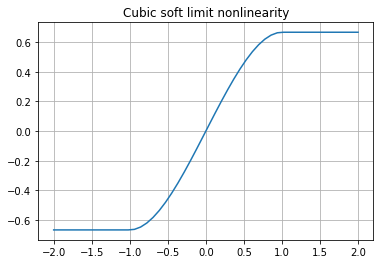

In [29]:
x = np.linspace(-2, 2, 50)
plt.plot(x, [cubic_soft_limit(x_i) for x_i in x])
plt.grid(True)
plt.title('Cubic soft limit nonlinearity')

In [30]:
def distort(signal, gain=1.5):
    return [cubic_soft_limit(x_i) for x_i in (signal / (signal.max()) * gain)]

# crazy amounts of gain needed for this particular pluck signal (sustain is so much lower volume than onset)
display.Audio(distort(doubled_pluck, gain=50), rate=fs)

This is a reasonable string model, and there's already a lot here to play with. There are a vast number of things that aren't accounted for here. However, we can achieve greater realism using only these components by
1. designing the _loop filter_ to match the transfer function of a real instrument
2. modelling the _excitation signal_ to emulate a realistic striking or plucking (such as plucking with a finger)

Both of these and much more will be addressed in Chapter 9!

Here's a goodbye chord:

In [31]:
notes = np.array([1, 5, 8, 12, 13]) # 7 chord
root_hz = 110 # low A
notes_hz = root_hz * 2**(notes / 12)
note_length_seconds = 4
between_notes_seconds = 1 / 16
strum_samples = np.zeros(int(fs * (note_length_seconds + between_notes_seconds * notes.size)))
for i, note_hz in enumerate(notes_hz):
    offset_samples = int(i * fs * between_notes_seconds)
    for frequency in [note_hz, note_hz + 0.2]:
        strum_samples[offset_samples:offset_samples + fs * note_length_seconds] += generate_pluck(frequency, length_seconds=note_length_seconds, fs=fs)

In [32]:
display.Audio(strum_samples, rate=fs)

Add some gnarly distortion...

In [33]:
display.Audio(distort(strum_samples, gain=50), rate=fs)

or a flanger (from [Chapter 5](https://nbviewer.jupyter.org/github/khiner/notebooks/blob/master/physical_audio_signal_processing/chapter_5_time_varying_delay_effects.ipynb))

In [34]:
import importlib
from Delay import Delay

delay = Delay(fs)
delay.set_delay_samples(0)
# flanger-like delay growth. See notebook for Ch5.
delay.set_delay_growth_samples(0.001)
display.Audio(delay.tick_all(strum_samples), rate=fs)

Hmm, bummer there are some light zipper effects in that example. These aren't audible to my ears in the case of this speech sample. Seems like it has something to do with the periodicity of the generated signal interacting with the incrementing delay?

In [35]:
from scipy.io.wavfile import read as readwav

delay.set_delay_samples(0)

fs, samples = readwav('speech-male.wav')
display.Audio(delay.tick_all(samples), rate=fs)